<center> <h1 style="background-color:none; color:#1f77b4; font-size:36px; font-weight:bold; font-family:Adobe Hebrew;" >Timeseries Forecasting with Facebook Prophet Model</h1></center>


<left> <h1 style="color:teal; font-size:32px; font-weight:bold; font-family:Adobe Garamond Pro;" >1. Import Libraries and frameworks</h1></left>

In [8]:
import pandas as pd
import numpy as np
import kaggle 
import os 
import zipfile
import datetime
import matplotlib.pyplot as plt
from prophet import Prophet
from scipy.stats import uniform
from mango import scheduler, Tuner # for hyperparameter tuning

In [9]:
# Error Metrics
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Define Mean Absolute Percentage Error (MAPE) metric
def MAPE(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)  # Convert to numpy array
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [10]:
# Suppress error and  the logging messages from cmdstanpy
import warnings, logging, cmdstanpy
warnings.filterwarnings("ignore")
logging.getLogger('cmdstanpy').setLevel(logging.WARNING)

In [11]:
#for visualization- we use matplotlib, seaborn and ploty
import matplotlib.pyplot as plt # 
import seaborn as sns
import matplotlib_inline.backend_inline
matplotlib_inline.backend_inline.set_matplotlib_formats("svg")
import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots 

def set_default_style():
    plt.style.use(['ggplot'])
    plt.rcParams.update({
        'axes.edgecolor': 'w', 'axes.titlesize': 12, 'axes.titleweight': 'bold',
        'axes.labelweight': 'bold', 'axes.labelsize': 10, 'axes.grid': False,
        'text.color': 'navy', 'figure.figsize': (9, 3.5), 'figure.dpi': 150})
    px.defaults.width = 900
    px.defaults.height = 350
    px.defaults.color_continuous_scale = px.colors.sequential.Plasma_r 
    px.defaults.color_discrete_sequence = px.colors.qualitative.T10
set_default_style()
# Define default layout and trace update parameters  for plotly plot
default_layout_params = {'title_font_size': 15, 'title_font_color': 'navy', 'title_x': 0.5,
                        'margin': dict(t=40, b=0, l=0, pad=5),
                        'width': 900, 'height': 300} 
default_trace_params = dict(marker_line_color='black', marker_line_width=1,opacity=1) 
pio.renderers.default = "svg"  
pd.set_option('display.max_columns', None,
              'display.max_rows', 200,
              'display.width', 400)
pd.options.display.float_format = '{:,.2f}'.format  

<left> <h1 style="color:teal; font-size:32px; font-weight:bold; font-family:Adobe Garamond Pro;" >2. Load/Import and Read the datasets</h1></left>

In [12]:
#Load the datasets
!kaggle datasets download -d 'robikscube/hourly-energy-consumption'
os.makedirs('data/energy/', exist_ok=True)
!unzip hourly-energy-consumption.zip -d data/energy/
os.remove('hourly-energy-consumption.zip')

Dataset URL: https://www.kaggle.com/datasets/robikscube/hourly-energy-consumption
License(s): CC0-1.0
 96%|████████████████████████████████████▌ | 11.0M/11.4M [00:01<00:00, 7.24MB/s]
100%|██████████████████████████████████████| 11.4M/11.4M [00:01<00:00, 7.13MB/s]
Archive:  hourly-energy-consumption.zip
  inflating: data/energy/AEP_hourly.csv  
  inflating: data/energy/COMED_hourly.csv  
  inflating: data/energy/DAYTON_hourly.csv  
  inflating: data/energy/DEOK_hourly.csv  
  inflating: data/energy/DOM_hourly.csv  
  inflating: data/energy/DUQ_hourly.csv  
  inflating: data/energy/EKPC_hourly.csv  
  inflating: data/energy/FE_hourly.csv  
  inflating: data/energy/NI_hourly.csv  
  inflating: data/energy/PJME_hourly.csv  
  inflating: data/energy/PJMW_hourly.csv  
  inflating: data/energy/PJM_Load_hourly.csv  
  inflating: data/energy/est_hourly.paruqet  
  inflating: data/energy/pjm_hourly_est.csv  


In [13]:
# Read the dataset
df = pd.read_csv('data/energy/PJME_hourly.csv')
print(f"Overview of the dataset\n{'￣ ￣ ￣ ' * 4}\n{df.head()}")

Overview of the dataset
￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ 
              Datetime   PJME_MW
0  2002-12-31 01:00:00 26,498.00
1  2002-12-31 02:00:00 25,147.00
2  2002-12-31 03:00:00 24,574.00
3  2002-12-31 04:00:00 24,393.00
4  2002-12-31 05:00:00 24,860.00


In [14]:
# Convert to datetime, sort in chronological order, and set to Datetime index
df['Datetime'] = pd.to_datetime(df['Datetime'])
df = df.sort_values(by='Datetime').set_index('Datetime')
print(f"Overview of the dataset\n{'￣ ￣ ￣' * 4}\n{df}")

Overview of the dataset
￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣
                      PJME_MW
Datetime                     
2002-01-01 01:00:00 30,393.00
2002-01-01 02:00:00 29,265.00
2002-01-01 03:00:00 28,357.00
2002-01-01 04:00:00 27,899.00
2002-01-01 05:00:00 28,057.00
...                       ...
2018-08-02 20:00:00 44,057.00
2018-08-02 21:00:00 43,256.00
2018-08-02 22:00:00 41,552.00
2018-08-02 23:00:00 38,500.00
2018-08-03 00:00:00 35,486.00

[145366 rows x 1 columns]


`Refine Problem Statement`: 

The dataset consists of 17 years of hourly energy consumption records for PJME from 2002 to 2018. It contains 145,366 instances of hourly data, with two features: datetime and energy consumption measured in Megawatts (MW). Our objective is to forecast hourly energy consumption of the next year(next twelve months) using historical (previous 16 years) data. 


<left> <h1 style="color:teal; font-size:32px; font-weight:bold; font-family:Adobe Garamond Pro;" >3. Data Cleaning and Preprocessing</h1></left>

<left> <h2 style="color:#1f77b4; font-size:24px; font-weight:bold; font-family:Adobe Garamond Pro;" >3.1 Explore the dataset</h2></left>
We do `Explore the dataset` to reveal key details about the datasets, such as data types, structure, and summary statistics. This will help identify errors, inconsistencies, or patterns, aiding in further data cleaning and preprocessing.'
- Identify and handle datasets and corrosponding columns with `missing values and duplicates`.
- Identify and handle `Irregularities in Data Entries` - data schema consistence
- Inspecting data for any outliers and treatment of those `outliers`


In [15]:
def explore_dataset(dfs):
    summary = []
    for column in sorted(dfs.columns):  
        data_type = dfs[column].dtype
        total_count = len(dfs[column])
        unique_count = dfs[column].nunique()
        unique_sample = dfs[column].unique()[0:10]
        missing_values = dfs[column].isnull().sum()
        summary.append({'Column': column, 
                        'Data Type': data_type, 
                        'Total Count': total_count,
                        'Unique Count': unique_count, 
                        'Unique Sample': unique_sample, 
                        'Missing Values': missing_values})
    return pd.DataFrame(summary)
print(f"\n Explore the datasets key information\n{'￣ ￣ ￣'*7}")
display(explore_dataset(df))

# Check for duplicate timestamp
duplicate_timestamp = df.index.duplicated(keep=False)
print(f"\nThe dataset has {duplicate_timestamp.sum()} duplicate rows.")


 Explore the datasets key information
￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣


,Column,Data Type,Total Count,Unique Count,Unique Sample,Missing Values
0,PJME_MW,float64,145366,28441,"[30393.0, 29265.0, 28357.0, 27899.0, 28057.0, ...",0



The dataset has 8 duplicate rows.


Fortunately, our dataset is well-maintained, with no missing values or irregularities in data entry or recording. All instances of energy consumption values are appropriately formatted as floats, and the Datetime column has been correctly converted to datetime format. However, we have identified eight duplicate rows that need to be addressed, as indicated by the summary output above.

<left> <h2 style="color:#1f77b4; font-size:24px; font-weight:bold; font-family:Adobe Garamond Pro;" >3.2 Handling Missing and Duplicate Values and Irregularities</h2></left>

In [16]:
# Handle and remove duplicate rows
duplicated_rows = df[duplicate_timestamp]
print(f" Duplicate rows to be handled \n{'￣ ￣ ￣'*5}")
print(f"{duplicated_rows}\n") # there are only 8 of them
print(f"Shape before removing duplicates: {df.shape}")

df = df[~duplicate_timestamp]  # Remove duplicates based on timestamp
print(f"Shape after removing duplicates: {df.shape}")
print(f"The dataset has {df.index.duplicated(keep=False).sum()} duplicate rows.")

 Duplicate rows to be handled 
￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣
                      PJME_MW
Datetime                     
2014-11-02 02:00:00 23,755.00
2014-11-02 02:00:00 22,935.00
2015-11-01 02:00:00 21,567.00
2015-11-01 02:00:00 21,171.00
2016-11-06 02:00:00 20,795.00
2016-11-06 02:00:00 21,692.00
2017-11-05 02:00:00 21,236.00
2017-11-05 02:00:00 20,666.00

Shape before removing duplicates: (145366, 1)
Shape after removing duplicates: (145358, 1)
The dataset has 0 duplicate rows.


<left> <h2 style="color:#1f77b4; font-size:24px; font-weight:bold; font-family:Adobe Garamond Pro;" >3.3 Detecting and Handling Outliers</h2></left>
Outliers are often defined as data points that fall outside a certain range, like 1.5 times the interquartile range (the difference between Q3 and Q1). The same range is considered to detect outliers in our data points. If the data points have a normal distribution, the outlier data points will be 0.7% of the data. 

we will utilize the quartile method. This approach involves calculating the first quartile (Q1) and the third quartile (Q3) of the data, and then determining the interquartile range (IQR), which is the difference between Q3 and Q1. Outliers are defined as data points that fall below Q1 - 1.5 * IQR or above Q3 + 1.5 * IQR.  

After identifying potential outliers using the quartile method, we will plot these data points to visually confirm their status as outliers. This helps in understanding the context and impact of the outliers within the dataset.

In [17]:
# Define quartiles and IQR
Q1, Q3 = df["PJME_MW"].quantile([0.25, 0.75])
IQR = Q3 - Q1

# Identify and print amounts of outlier data points
outliers = df[(df["PJME_MW"] < Q1 - 1.5 * IQR) | (df["PJME_MW"] > Q3 + 1.5 * IQR)]
print(f"Total outliers in PJME_MW feature: {outliers.shape[0]}\n")

Total outliers in PJME_MW feature: 3456



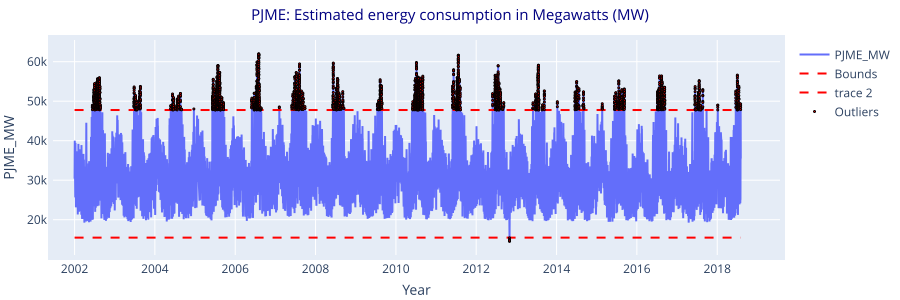

In [18]:
# Plotting outliers with lower and upper bounds 
fig = go.Figure()
fig.add_trace(go.Scatter(x=df.index, y=df["PJME_MW"], mode='lines', name="PJME_MW")) # Main line plot

# Bounds
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

fig.add_trace(go.Scatter(x=df.index, y=[lower_bound] * len(df),
                         mode='lines', line=dict(dash='dash', color='red'),
                         name='Bounds'))
fig.add_trace(go.Scatter(x=df.index, y=[upper_bound] * len(df),
                         mode='lines', line=dict(dash='dash', color='red'),
                         showlegend=False))
# Outliers
fig.add_trace(go.Scatter(x=outliers.index, y=outliers['PJME_MW'],
                         mode='markers', marker=dict(color='red', size=2),
                         name='Outliers'))
fig.update_layout(title=f'PJME: Estimated energy consumption in Megawatts (MW)',
                  xaxis_title='Year', yaxis_title='PJME_MW', **default_layout_params)
fig.update_traces(**default_trace_params, showlegend=True)
fig.show()


We have identified that the target feature contains several outliers. However, a closer examination of the plot indicates that the data points labeled as outliers at the upper bound are not true outliers. Instead, they reflect seasonal peaks and troughs. These points should not be removed merely because they are identified as outliers. We should `ensure that they are not incorrectly entered instances or measurement errors` before considering their removal.

Most of the data points on the lower bound  side are about 20K or above. However, there is a particular instance that appears to be an outlier, possibly due to sensor failure or measurement error, which should be removed.

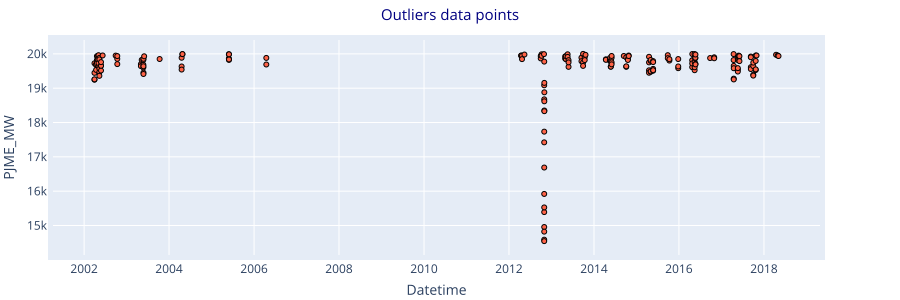

In [19]:
#Query and plot outlier data points.
outliers_data_pts = df.query('PJME_MW <= 20000')
fig = go.Figure()
fig.add_trace(go.Scatter(x=outliers_data_pts.index, y=outliers_data_pts['PJME_MW'], 
                         mode='markers', marker=dict(color='tomato', size=5), 
                         name='PJME_MW'))
fig.update_layout(title=f'Outliers data points',
                  xaxis_title='Datetime', yaxis_title='PJME_MW', 
                  **default_layout_params)
fig.update_traces(**default_trace_params)
fig.show()

In [20]:
#The outliers data points are below 19k, Hence we remove it.
df = df.query('PJME_MW > 19000').copy() # create copy of it

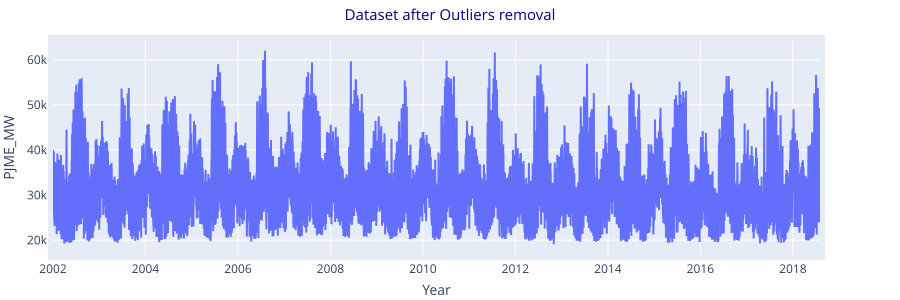

In [21]:
#After after outliers removal
fig = go.Figure()
fig.add_trace(go.Scatter(x=df.index, y=df['PJME_MW'], mode='lines', name='PJME_MW'))
fig.update_layout(title=f'Dataset after Outliers removal',
                  xaxis_title='Year', yaxis_title='PJME_MW',
                  **default_layout_params)
fig.show()

<left> <h1 style="color:teal; font-size:32px; font-weight:bold; font-family:Adobe Garamond Pro;" >4. EDA and Feature Engineering</h1></left>

**`Create Datetime Features`**
Since we are working with Univariate time series datasets, We don't have much feature to do EDA, Hence, we need to create timeseries feature for Datetime.  Creating features from time series data involves transforming the datetime information into additional variables that can provide valuable insights or improve the performance of machine learning models. 
Here are some of the features we will create from the timeseries date
- **Hour**: The hour of the day (0-23), used to capture daily patterns.
- **Day of the Month (dayofmonth)**: The day of the month (1-31), used to capture monthly effects.
- **Day of the Week (dayofweek)**: The day of the week (0=Monday, 6=Sunday), used to capture weekly patterns.
- **Weekday**: Indicates whether the day is a weekday (often 0 for weekdays and 1 for weekends), used to distinguish between weekdays and weekends.
- **Week of the Year (weekofyear)**: The week number within the year (1-52 or 1-53), used to capture weekly patterns over the year.
- **Month**: The month of the year (1-12), used to capture monthly seasonality.
- **Quarter**: The quarter of the year (1-4), used to identify seasonal trends on a quarterly basis.
- **Season**: The season of the year (e.g., Winter, Spring, Summer, Autumn), used to capture broader seasonal trends.
- **Day of the Year (dayofyear)**: The day number within the year (1-365 or 1-366 in leap years), used to model yearly seasonality.
- **Year**: The year component of the date, used to capture long-term trends and changes over years.

In [22]:
def create_features(df, label=None):
    df['hour'] = df.index.hour
    df['dayofweek'] = df.index.dayofweek
    df['weekday'] = df.index.strftime('%A')
    df['quarter'] = df.index.quarter
    df['month'] = df.index.month
    df['month_n'] = df.index.strftime('%B')  # Month name
    df['year'] = df.index.year
    df['dayofyear'] = df.index.dayofyear
    df['dayofmonth'] = df.index.day
    df['weekofyear'] = df.index.isocalendar().week
    
    # Identify the four seasons
    date_offset = (df.index.month * 100 + df.index.day - 320) % 1300
    df['season'] = pd.cut(date_offset, [0, 300, 602, 900, 1300], 
                          labels=['Spring', 'Summer', 'Fall', 'Winter'])
    
    # Select feature columns
    feature_cols = ['hour', 'dayofweek', 'weekday', 'dayofmonth', 'month', 
                    'month_n', 'dayofyear', 'weekofyear', 'quarter', 'season', 'year']
    X = df[feature_cols]
    return (X, df[label]) if label else X


# Example usage
X, y = create_features(df, label='PJME_MW')
df_f = pd.concat([X, y], axis=1)
print(f"\n Dataset with timeseries Features \n{'￣ ￣ ￣' * 5}")
display(df_f)



 Dataset with timeseries Features 
￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣


,hour,dayofweek,weekday,dayofmonth,month,month_n,dayofyear,weekofyear,quarter,season,year,PJME_MW
Datetime,,,,,,,,,,,,
2002-01-01 01:00:00,1,1,Tuesday,1,1,January,1,1,1,Winter,2002,"30,393.00"
2002-01-01 02:00:00,2,1,Tuesday,1,1,January,1,1,1,Winter,2002,"29,265.00"
2002-01-01 03:00:00,3,1,Tuesday,1,1,January,1,1,1,Winter,2002,"28,357.00"
2002-01-01 04:00:00,4,1,Tuesday,1,1,January,1,1,1,Winter,2002,"27,899.00"
2002-01-01 05:00:00,5,1,Tuesday,1,1,January,1,1,1,Winter,2002,"28,057.00"
...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,20,3,Thursday,2,8,August,214,31,3,Summer,2018,"44,057.00"
2018-08-02 21:00:00,21,3,Thursday,2,8,August,214,31,3,Summer,2018,"43,256.00"
2018-08-02 22:00:00,22,3,Thursday,2,8,August,214,31,3,Summer,2018,"41,552.00"


 Let's analyze the data using the feature we created. We will use box plot visualizations to understand the distribution of hourly energy consumption, identify trends, and later verify if our model captures these trends. We will plot:

- **Hourly energy consumption**: To identify low and peak hours of energy usage within a 24-hour day.
- **Daily hourly energy consumption during a week**: To determine which days have higher or lower hourly energy consumption and how seasonal periods affect daily energy consumption.
- **Monthly hourly energy consumption during a year**: To observe which months have peak or low hourly energy consumption.
- **Yearly hourly energy consumption over a given time period**: To analyze the yearly trend in hourly energy consumption.

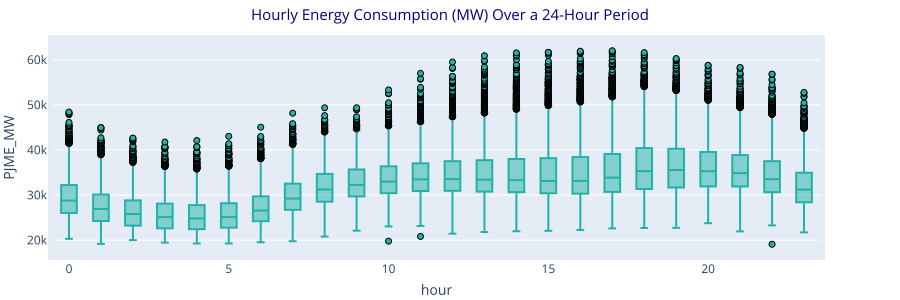

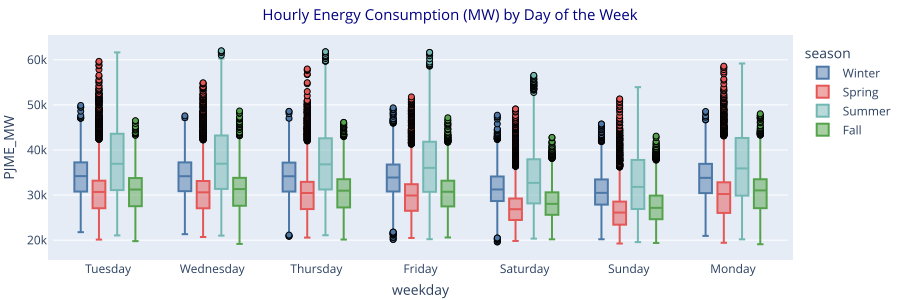

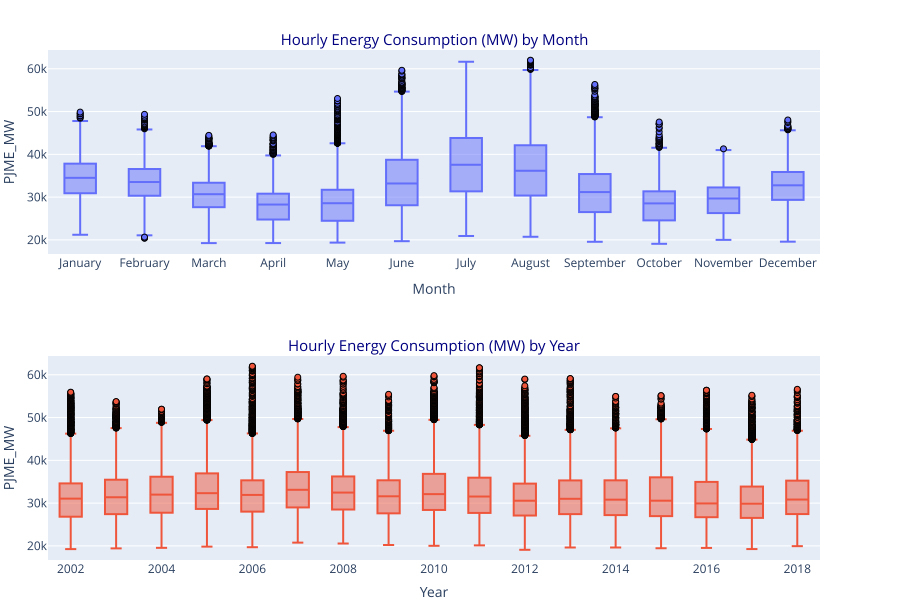

In [23]:
# Plot Hourly Energy Consumption (MW) Over a 24-Hour Period
fig1 = px.box(df_f, x="hour", y="PJME_MW", color_discrete_sequence=['lightseagreen'])
title = 'Hourly Energy Consumption (MW)' # for convenience
fig1.update_layout(title=f'{title} Over a 24-Hour Period', **default_layout_params)
fig1.update_traces(**default_trace_params)
fig1.show()

# Plot Hourly Energy Consumption (MW) by Day of the Week
fig2 = px.box(df_f, x="weekday", y="PJME_MW", color='season')
fig2.update_layout(title=f'{title} by Day of the Week', **default_layout_params)
fig2.update_traces(**default_trace_params)
fig2.show()

# Plot Monthly and Yearly Hourly Energy Consumption (MW)
fig3 = make_subplots(rows=2, cols=1, vertical_spacing=0.2,
                     subplot_titles=(f'{title} by Month', f'{title} by Year'))                 
fig3.add_trace(go.Box(x=df_f['month_n'], y=df_f['PJME_MW']), row=1, col=1)
fig3.add_trace(go.Box(x=df_f['year'], y=df_f['PJME_MW']), row=2, col=1)
fig3.update_xaxes(title_text='Month', row=1, col=1)
fig3.update_xaxes(title_text='Year', row=2, col=1)
fig3.update_yaxes(title_text='PJME_MW')
fig3.update_layout(margin=dict(t=50, b=10, l=0, pad=0), width=900, height=600)
fig3.update_annotations(font=dict(size=15, color="navy"))
fig3.update_traces(**default_trace_params, showlegend=False)
fig3.show()

**Observation**:
- The box plot shows that hourl energy consumption is low early in the morning (1:00 AM - 7:00 AM) and peaks from late afternoon (3:00 PM - 6:00 PM) to evening (6:00 PM - 9:00 PM).
- Energy use is lower on weekends, especially Sundays, while weekdays show similar peaks. Summer and winter have high consumption, whereas spring and fall have low consumption.
- Monthly data reflect these seasonal trends: high in summer and winter, low in fall and spring.
- Yearly data show consistent energy consumption with no significant changes over the years.
The models we implement should identify these trends.

"After completing the EDA, we will drop redundant features like month name, weekday, and quarter, but retain the season feature for its relevance, and map season name to a number using label encoding."

In [24]:
# Label encoding of seasons
season_mapping = {'Winter': 1, 'Spring': 2, 'Summer': 3, 'Fall': 4}
df_f['season'] = df_f['season'].map(season_mapping)
df_f.drop(['weekday', 'month_n', 'quarter'], axis=1, inplace=True) # Drop unnecessary features

print(f"\n Data with selected timeseries Features\n{'￣ ￣ ￣' * 10}")
display(df_f)



 Data with selected timeseries Features
￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣￣ ￣ ￣


,hour,dayofweek,dayofmonth,month,dayofyear,weekofyear,season,year,PJME_MW
Datetime,,,,,,,,,
2002-01-01 01:00:00,1,1,1,1,1,1,1,2002,"30,393.00"
2002-01-01 02:00:00,2,1,1,1,1,1,1,2002,"29,265.00"
2002-01-01 03:00:00,3,1,1,1,1,1,1,2002,"28,357.00"
2002-01-01 04:00:00,4,1,1,1,1,1,1,2002,"27,899.00"
2002-01-01 05:00:00,5,1,1,1,1,1,1,2002,"28,057.00"
...,...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,20,3,2,8,214,31,3,2018,"44,057.00"
2018-08-02 21:00:00,21,3,2,8,214,31,3,2018,"43,256.00"
2018-08-02 22:00:00,22,3,2,8,214,31,3,2018,"41,552.00"


<left> <h1 style="color:teal; font-size:32px; font-weight:bold; font-family:Adobe Garamond Pro;" >5. Format the Dataset for Prophet Model using</h1></left>

<left> <h2 style="color:#1f77b4; font-size:24px; font-weight:bold; font-family:Adobe Garamond Pro;" >5.1 Train and Test Split</h2></left>

In non-time series  machine learning implementaion, train/test split splits the data randomly, as there’s no dependence from one observation to the other. That’s not the case with time series data. Here, we want to use values at the rear of the dataset for testing and everything else for training. We will use the previous years data to predict the  last year. hence, we split the data accordingly. 

In [25]:
split_date = '2016-08-03'  # Define split_date

train_df = df_f.loc[df_f.index <= split_date].copy()
test_df = df_f.loc[df_f.index > split_date].copy()

print(f"\n Training dataset \n{'￣ ￣ ￣ ' * 10}")
display(train_df)

print(f"\n Testing dataset \n{'￣ ￣ ￣ ' * 10}")
display(test_df)



 Training dataset 
￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ 


,hour,dayofweek,dayofmonth,month,dayofyear,weekofyear,season,year,PJME_MW
Datetime,,,,,,,,,
2002-01-01 01:00:00,1,1,1,1,1,1,1,2002,"30,393.00"
2002-01-01 02:00:00,2,1,1,1,1,1,1,2002,"29,265.00"
2002-01-01 03:00:00,3,1,1,1,1,1,1,2002,"28,357.00"
2002-01-01 04:00:00,4,1,1,1,1,1,1,2002,"27,899.00"
2002-01-01 05:00:00,5,1,1,1,1,1,1,2002,"28,057.00"
...,...,...,...,...,...,...,...,...,...
2016-08-02 20:00:00,20,1,2,8,215,31,3,2016,"41,056.00"
2016-08-02 21:00:00,21,1,2,8,215,31,3,2016,"40,151.00"
2016-08-02 22:00:00,22,1,2,8,215,31,3,2016,"38,662.00"



 Testing dataset 
￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ ￣ 


,hour,dayofweek,dayofmonth,month,dayofyear,weekofyear,season,year,PJME_MW
Datetime,,,,,,,,,
2016-08-03 01:00:00,1,2,3,8,216,31,3,2016,"29,462.00"
2016-08-03 02:00:00,2,2,3,8,216,31,3,2016,"27,717.00"
2016-08-03 03:00:00,3,2,3,8,216,31,3,2016,"26,540.00"
2016-08-03 04:00:00,4,2,3,8,216,31,3,2016,"25,912.00"
2016-08-03 05:00:00,5,2,3,8,216,31,3,2016,"26,030.00"
...,...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,20,3,2,8,214,31,3,2018,"44,057.00"
2018-08-02 21:00:00,21,3,2,8,214,31,3,2018,"43,256.00"
2018-08-02 22:00:00,22,3,2,8,214,31,3,2018,"41,552.00"


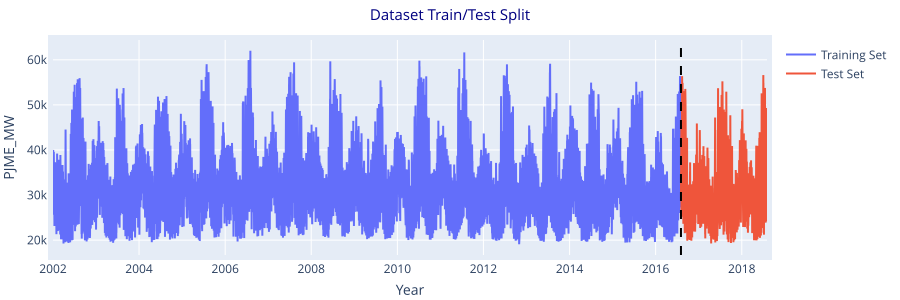

In [26]:
# Plot train and test split
fig = go.Figure([
    go.Scatter(x=train_df.index, y=train_df['PJME_MW'], mode='lines', name='Training Set'),
    go.Scatter(x=test_df.index, y=test_df['PJME_MW'], mode='lines', name='Test Set')])

fig.add_vline(x=pd.to_datetime(split_date), line=dict(color='black', dash='dash'))
fig.update_layout(title='Dataset Train/Test Split',
                  xaxis_title='Year', yaxis_title='PJME_MW',
                  **default_layout_params)
fig.show()

<left> <h2 style="color:#1f77b4; font-size:24px; font-weight:bold; font-family:Adobe Garamond Pro;" >5.2 Format/convert to Univariate with Conventional Naming</h2></left>

The prophet model is designed for univariate timeseries forecasting, hence we only need Datetime and corrospondly energy consumption value. We must adhere to a specific naming convention: the datetime column should be labeled "ds" and the target variable (energy consumption) should be labeled "y".

In [27]:
# Prepare DataFrame for Prophet model
cols = {'Datetime': 'ds', 'PJME_MW': 'y'}
train_df_prophet = train_df.reset_index()[['Datetime', 'PJME_MW']].rename(columns=cols)
test_df_prophet = test_df.reset_index()[['Datetime', 'PJME_MW']].rename(columns=cols)

print(f"\nTraining dataset for Prophet model \n{'￣ ￣' * 10}\n{train_df_prophet.head()}")
print(f"\n Testing dataset for Prophet model \n{'￣ ￣' * 10}\n{test_df_prophet.head()}")


Training dataset for Prophet model 
￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣
                   ds         y
0 2002-01-01 01:00:00 30,393.00
1 2002-01-01 02:00:00 29,265.00
2 2002-01-01 03:00:00 28,357.00
3 2002-01-01 04:00:00 27,899.00
4 2002-01-01 05:00:00 28,057.00

 Testing dataset for Prophet model 
￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣
                   ds         y
0 2016-08-03 01:00:00 29,462.00
1 2016-08-03 02:00:00 27,717.00
2 2016-08-03 03:00:00 26,540.00
3 2016-08-03 04:00:00 25,912.00
4 2016-08-03 05:00:00 26,030.00


<left> <h1 style="color:teal; font-size:32px; font-weight:bold; font-family:Adobe Garamond Pro;" >6. Prophet Model </h1></left>

Prophet is a decomposable time series model that assumes the observed time series $y_t$ can be described as a sum of the following components:
\begin{equation}
y_t = g(t) + s(t) + h(t) + \epsilon_t
\end{equation}
Where:
- $ g(t)$ is the trend component: captures non-periodic changes in the value of the time series.
- $ s(t)$ is the seasonality component: Captures periodic changes (e.g., weekly, yearly).
- $ h(t)$ is the holiday component: Captures the effects of holidays and special events.
- $ \epsilon_t $is the error term : Captures any idiosyncratic changes not explained by the other components

To establish a baseline forecast, we create a Prophet() object and fit it to our training dataset. The default model is designed to automatically configure itself based on the characteristics of the data, determining appropriate parameters and settings to optimize its performance for the given dataset. This allows us to efficiently generate an initial forecast without extensive manual tuning. 

**`Model Evaluation`**

For evaluating the performance of our models, We will use R-squared ($R^2$),  Root Mean Squared Error (RMSE), Mean Absolute Percentage Error(MAPE). 

**R-squared ($R^2$)**: R-squared, or the coefficient of determination, measures the proportion of variance in the dependent variable explained by the independent variable, ranging from 0 to 1. A value of 1 indicates a perfect fit, while a lower value suggests poor model performance. It is calculated as:
​
\begin{equation*}
R^2 = 1 - \frac{\sum_{i=1}^{n} (y_i - \hat{y}_i)^2}{\sum_{i=1}^{n} (y_i - \bar{y})^2},
\end{equation*}

where $\hat{y}_i$ is the predicted value, $y_i$ is the true value, and $\bar{y}$ is the mean of the true values.


**Root Mean Squared Error (RMSE)**: RMSE provides a single number that represents the typical difference between predicted and actual values, with lower values indicating better model performance.
​
If $\hat{y}_i$ is the predicted value of the $i$-th element, and $y_i$ is the corresponding true value, then for all $n$ elements, RMSE is calculated as:
​
\begin{equation*}
\text{RMSE}(y, \hat{y}) = \sqrt{\frac{1}{n} \sum_{i=1}^{n} (y_i - \hat{y}_i)^2}.
\end{equation*}

**MAPE**: is a metric mostly commonly used to measure the accuracy of a forecasting model. It expresses the prediction error as a percentage, providing an intuitive understanding of the model's performance. Lower MAPE values indicate better accuracy. MAPE is calculated as:

\begin{equation}
\text{MAPE} = \frac{1}{n} \sum_{i=1}^{n} \left| \frac{y_i - \hat{y}_i}{y_i} \right| \times 100
\end{equation}


where $y_i$ is the true value, $\hat{y}_i$ is the predicted value, and $n$ is the number of observations.

In [28]:
#fit the model
prophet_model = Prophet() 
prophet_model.fit(train_df_prophet) 

23:21:14 - cmdstanpy - INFO - Chain [1] start processing
23:21:41 - cmdstanpy - INFO - Chain [1] done processing


In [29]:
# Make prediction on the test dataset with baseline model
prophet_bl_forecast = prophet_model.predict(test_df_prophet)

# Display relevant columns
display(prophet_bl_forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]) 

,ds,yhat,yhat_lower,yhat_upper
0,2016-08-03 01:00:00,"33,426.27","28,969.76","37,623.94"
1,2016-08-03 02:00:00,"31,936.83","27,173.34","36,305.92"
2,2016-08-03 03:00:00,"31,076.72","26,305.72","35,477.31"
3,2016-08-03 04:00:00,"30,945.60","26,566.15","35,521.88"
4,2016-08-03 05:00:00,"31,629.32","26,986.79","36,086.96"
...,...,...,...,...
17511,2018-08-02 20:00:00,"41,293.88","29,935.68","52,494.32"
17512,2018-08-02 21:00:00,"40,517.11","29,006.06","51,848.04"
17513,2018-08-02 22:00:00,"38,893.68","26,939.95","50,099.67"
17514,2018-08-02 23:00:00,"36,702.48","26,101.88","48,303.51"


The Prophet model includes a built-in feature to plot the components of the model, allowing us to verify if it has accurately captured the trends identified during analysis. We can extract components such as yearly, daily, and weekly patterns, and visualize them using our preferred visualization library. By default, Prophet uses Matplotlib for plotting these components, which we can leverage for our visualizations.

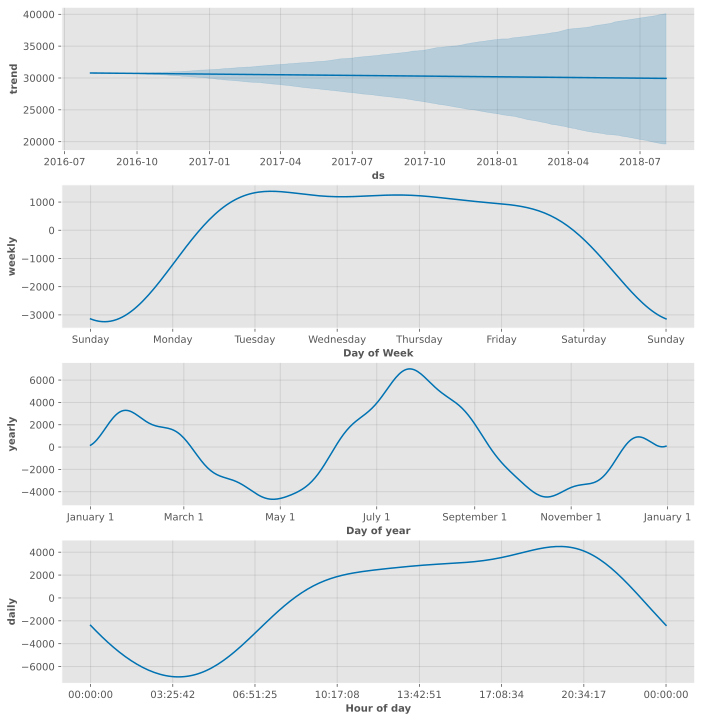

In [30]:
# Plot the components of the model
fig = prophet_model.plot_components(prophet_bl_forecast) 
fig.set_size_inches(10, 10) 
plt.show()

The plot of the Prophet model components, displaying hourly, daily, weekly, and yearly trends, indicates that the model effectively captures the underlying patterns in the data. This observation aligns well with the trends identified during our earlier EDA.

Next, let's visualize the forecast alongside the actual data points to assess the alignment. 

In [31]:
# Plot the forecast with the actuals
fig, ax = plt.subplots(figsize=(10, 4))
ax.set_title('Forecast vs Actuals')
ax.scatter(test_df_prophet['ds'], test_df_prophet['y'], color='tomato', label='Actuals')
fig = prophet_model.plot(prophet_bl_forecast, ax=ax) 
ax.legend(loc='lower center', frameon=False)
plt.tight_layout()
plt.show()

In [32]:
# Create function - to evaluate model and print error metrics
def model_eval(y_true, y_pred, model_name):
    eval_metrics = {'Model_name': model_name,
                    'RMSE': round(np.sqrt(mean_squared_error(y_true, y_pred)), 4),
                    'R2_score': round(r2_score(y_true, y_pred), 4),
                    'MAPE': MAPE(y_true, y_pred)}
    df_model_eval = pd.DataFrame([eval_metrics])
    
    print(f"\n{model_name} Model Performance \n{'￣ ￣' * 10}")
    print(df_model_eval)

In [33]:
y_true = test_df_prophet['y']
y_pred = prophet_bl_forecast['yhat']
model_eval(y_true, y_pred, 'Prophet_Baseline')


Prophet_Baseline Model Performance 
￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣
         Model_name     RMSE  R2_score  MAPE
0  Prophet_Baseline 4,258.55      0.55  9.89


The baseline prophet models achieved $R^2$ score of 0.55 and MAPE of 9.89%. Let's further improve the model with hyperparameter tuning. 

<left> <h1 style="color:teal; font-size:32px; font-weight:bold; font-family:Adobe Garamond Pro;" >7. Hyperparameter Tuning of the Prophet model</h1></left>

Hyperparameter tuning plays a pivotal role in minimizing the loss function of a model, thereby enhancing prediction accuracy while mitigating overfitting. Prophet, with its numerous hyperparameters, makes traditional grid and random search methods computationally intensive.  Hence, we utilize **Mango**, a hyperparameter tuning package that leverages Bayesian optimization. This approach efficiently identifies optimal hyperparameters with fewer iterations, making it particularly well-suited for complex models and large datasets.

After we identified best parameters, we will see if adding holiday indicators will help the accuracy of the model. Prophet comes with a Holiday Effects parameter that can be provided to the model prior to training.

**Parameters for Optimization**:
While the Prophet model offers a variety of input parameters open to tuning, not all parameters necessarily enhance performance, as advised by Facebook's guidelines. Therefore, we focus on optimizing the following recommended parameters.

In [34]:
param_space = dict(changepoint_range=uniform(0.8, 0.95),
                   seasonality_mode=['additive', 'multiplicative'],
                   seasonality_prior_scale=uniform(0.01, 10.0),
                   changepoint_prior_scale=uniform(0.001, 0.5),
                   holidays_prior_scale=uniform(0.01, 10.0))

In [35]:
#Hyperpamater tuning using mango
def mango_tuner(args_list):
    global train_df_prophet, test_df_prophet
    params_evaluated = []
    results = []
    for params in args_list:
        try:
            prophet_model = Prophet(**params)
            prophet_model.fit(train_df_prophet)
            prophet_bl_forecast = prophet_model.predict(test_df_prophet)
            error = MAPE(y_true=test_df_prophet['y'], y_pred=prophet_bl_forecast['yhat'])
            params_evaluated.append(params)
            results.append(error)
        # Handle exceptions by appending a high error
        except Exception as e:
            params_evaluated.append(params)
            results.append(50.0)  # High loss for exceptions
    return params_evaluated, results

conf_Dict = dict(initial_random=10, num_iteration=40)
tuner = Tuner(param_space, mango_tuner, conf_Dict)
results = tuner.minimize()
best_parameters = results['best_params'] # Assign to variable for later use
print('best loss:', results['best_objective'])

23:21:50 - cmdstanpy - INFO - Chain [1] start processing
23:22:18 - cmdstanpy - INFO - Chain [1] done processing
23:22:25 - cmdstanpy - INFO - Chain [1] start processing
23:22:53 - cmdstanpy - INFO - Chain [1] done processing


  0%|          | 0/40 [00:00<?, ?it/s]

23:23:02 - cmdstanpy - INFO - Chain [1] start processing
23:23:51 - cmdstanpy - INFO - Chain [1] done processing
23:24:03 - cmdstanpy - INFO - Chain [1] start processing
23:24:47 - cmdstanpy - INFO - Chain [1] done processing
23:24:55 - cmdstanpy - INFO - Chain [1] start processing
23:25:48 - cmdstanpy - INFO - Chain [1] done processing
23:25:56 - cmdstanpy - INFO - Chain [1] start processing
23:26:25 - cmdstanpy - INFO - Chain [1] done processing
23:26:33 - cmdstanpy - INFO - Chain [1] start processing
23:27:01 - cmdstanpy - INFO - Chain [1] done processing
23:27:09 - cmdstanpy - INFO - Chain [1] start processing
23:27:36 - cmdstanpy - INFO - Chain [1] done processing
23:27:44 - cmdstanpy - INFO - Chain [1] start processing
23:28:09 - cmdstanpy - INFO - Chain [1] done processing
23:28:19 - cmdstanpy - INFO - Chain [1] start processing
23:28:43 - cmdstanpy - INFO - Chain [1] done processing
23:28:51 - cmdstanpy - INFO - Chain [1] start processing
23:29:14 - cmdstanpy - INFO - Chain [1]

best loss: 9.62654964404485


In [36]:
# print(best parameters for reference
df_best_params = pd.DataFrame.from_dict(best_parameters, orient='index', columns=['Best params'])
print(df_best_params)

                            Best params
changepoint_prior_scale            0.05
changepoint_range                  0.81
holidays_prior_scale               1.09
seasonality_mode         multiplicative
seasonality_prior_scale            3.36



**Add Holidays**:
To further improve model performance, let's incorprate US holidays, as Prophet model accept such paramater. We create dataframe of all US holidays spanning the timeframe of our data.

In [37]:
from pandas.tseries.holiday import USFederalHolidayCalendar as calendar
cal = calendar()
holidays = cal.holidays(start=df_f.index.min(), end=df_f.index.max(), return_name=True)
holiday_df = pd.DataFrame({'ds': holidays.index, 'holiday': holidays.values})
print(holiday_df.head())

          ds                              holiday
0 2002-01-21  Birthday of Martin Luther King, Jr.
1 2002-02-18                Washington's Birthday
2 2002-05-27                         Memorial Day
3 2002-07-04                     Independence Day
4 2002-09-02                            Labor Day


In [38]:
from pandas.tseries.holiday import USFederalHolidayCalendar as calendar
cal = calendar()
holidays = cal.holidays(start=df_f.index.min(),end=df_f.index.max(), return_name=True)
holiday_df = pd.DataFrame(data=holidays, columns=['holiday'])
holiday_df = holiday_df.reset_index().rename(columns={'index':'ds'})
print(holiday_df.head())

          ds                              holiday
0 2002-01-21  Birthday of Martin Luther King, Jr.
1 2002-02-18                Washington's Birthday
2 2002-05-27                         Memorial Day
3 2002-07-04                     Independence Day
4 2002-09-02                            Labor Day


In [39]:
# Create the Prophet model with the tuned parameters
prophet_model_tuned = Prophet(holidays=holiday_df, **best_parameters)
prophet_model_tuned.fit(train_df_prophet) 

23:39:25 - cmdstanpy - INFO - Chain [1] start processing
23:39:57 - cmdstanpy - INFO - Chain [1] done processing


In [40]:
# Evlaute the model on testing set
prophet_bl_forecast_tuned = prophet_model_tuned.predict(test_df_prophet)
y_true = test_df_prophet['y']
y_pred = prophet_bl_forecast_tuned['yhat']
model_eval(y_true, y_pred, 'Prophet_Hyperparamater_Tuned')


Prophet_Hyperparamater_Tuned Model Performance 
￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣￣ ￣
                     Model_name     RMSE  R2_score  MAPE
0  Prophet_Hyperparamater_Tuned 4,230.14      0.55  9.60


Through rigorous hyperparameter tuning, we managed to improve model's Mean Absolute Percentage Error (MAPE) from 9.89% to 9.59%.

<left> <h1 style="color:teal; font-size:32px; font-weight:bold; font-family:Adobe Garamond Pro;" >8. Forecast into the Future </h1></left>
We employed hyperparameter tuned model, to predict into feature. We can use the built in make_future_dataframe method to build our future dataframe and make predictions. 

In [41]:
future = prophet_model.make_future_dataframe(periods=365*24, freq='h', include_history=False)
prophet_bl_forecast_tuned = prophet_model.predict(future) #forecast on test set
display(prophet_bl_forecast_tuned[['ds', 'yhat', 'yhat_lower', 'yhat_upper']])

,ds,yhat,yhat_lower,yhat_upper
0,2016-08-03 01:00:00,"33,426.27","28,945.62","37,523.89"
1,2016-08-03 02:00:00,"31,936.83","27,209.85","36,101.21"
2,2016-08-03 03:00:00,"31,076.72","26,537.77","35,800.15"
3,2016-08-03 04:00:00,"30,945.60","26,707.28","35,204.80"
4,2016-08-03 05:00:00,"31,629.32","27,304.75","36,256.43"
...,...,...,...,...
8755,2017-08-02 20:00:00,"41,950.01","36,532.14","47,364.08"
8756,2017-08-02 21:00:00,"41,179.99","35,532.45","46,907.99"
8757,2017-08-02 22:00:00,"39,562.15","34,152.32","45,667.14"
8758,2017-08-02 23:00:00,"37,375.56","31,573.08","43,286.91"


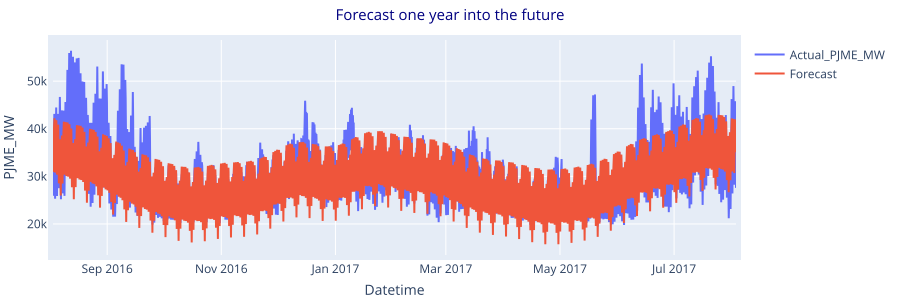

In [43]:
#Plot 
df_actual = test_df_prophet.head(365*24) #test_df_prophet.iloc[:periods]
df_fcst = prophet_bl_forecast_tuned
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_actual['ds'], y=df_actual['y'], mode='lines', name='Actual_PJME_MW'))
fig.add_trace(go.Scatter(x=df_fcst['ds'], y=df_fcst['yhat'], mode='lines', name='Forecast'))
fig.update_layout(title='Forecast one year into the future',
                  xaxis_title='Datetime', yaxis_title='PJME_MW',
                  **default_layout_params)
fig.show()